<a href="https://colab.research.google.com/github/evangstav/NewYorkBikesTaxisApp/blob/stable/Final_notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Andri Geir Arnarson - s164518 
Asger Fredrik Græsholt - s154099
Evangelos Stavropoulos - s193183

**Some cells tend to close whenever a new user opens it, please make sure to choos View-> Expand Sections before reading**

#### Imports and mounting

In [ ]:
!pip install osmnx
import osmnx as ox
!pip install colour

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import folium
import json
import seaborn as sns
import json
import plotly.express as px
import pickle
import math
import random
import warnings
import calendar
from colour import Color

from datetime import datetime

from tqdm import tqdm_notebook
sns.set()

from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
import joblib

from shapely.geometry import Point
from shapely.geometry.polygon import Polygon


In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


# 1 Motivation

This project aims to provide important insights into the different commuting options of the residents of New York City. The main focus will be on comparing taxi and bicycle commuters. As New York is famously known for its taxi culture which is expensive, inefficient at rush hours and has a greater carbon footprint than bicycles. The aim is therefore to answer the following research questions.



1.   How do the travel times compare around the clock?
2.   What is the cheapest and what is the most efficient travel choice at a given time?
3.   Where should initatives to improve bike-infrastructre be focused ?

Regarding the user experience the first aim is to convince the reader that chooseing a bike is just as good as taking a cab, both in regard to travel time as well as the price. This is done by first answering the first question comparing basic travel time mesurements. Then we will move on to building a model that can give the user a custom reccomendatoin based on the users input/needs. Finally looking at it from a perspective of someone who is supposed to implement improvement to the the bikeing infrastructure of New York we want recoment where to focus those improvements.




# 2 Basic stats

## Pre-proccessing 

The biggest challenge of the preprocessing was the amount of data we had in our hands. Both the taxi and the bike datasets had over 1 million observations per month. This limits us only to focus on a one year time span and forces us to take smaller samples when training machine learning models. 

Another challenge was domain knowledge. For an example did the weather data include features that we were not familiar with and measurements that to begin with did not make any sense to us.

A big part of the pre-processing also was converting numbers/coordinates and travel times to the same measurements. Also some basic extra variables such as the duration, distance and speed needed to be calculated based on timestamps and coordinates. These mesurements are something everybody understands and was essential in order to make meaningful and easily understandable visualizations.



## The data
Through out the project the main data reasources have been aquired from https://opendata.cityofnewyork.us/. Due to data quality the analysis was performed on data from 2016.

#### **Bike data** 
The bike data comes from the CitiBike system data. CititBike is a service where bikes parked at designated station scattered around the city can be rented. The dataset contains over one million observations per month and each observation has 14 features:


*  tripduration (seconds)
*  starttime (Datetime)
*  stoptime (Datetime)
*  start station id 
*  start station name
*  start station latitude
*  start station longitude
*  end station id
*  end station name
*  end station latitude
*  end station longitude
*  bike id
*  usertype (Customer/subscriber)
*  birth year 
*  gender


#### **Taxi data** 
The taxi data comes from the Green Taxi Trip data from 2016. The reason for choosing the green taxi data over the yellow ones is simply because the green taxi data provided more detailed longi- and latitude information. The dataset consists of 16.4 million observations with 23 features. During the data exploration we found out that the green taxis are banished from the lower manhatten area, where the iconic yellow taxis rule, this is also shown in the data analysis.

* VendorID
* lpep_pickup_datetime
* Lpep_dropoff_datetime
* Store_and_fwd_flag
* RateCodeID
* Pickup_longitude
* Pickup_latitude
* Dropoff_longitude
* Dropoff_latitude
* Passenger_count
* Trip_distance
* Fare_amount
* Extra
* MTA_tax
* Tip_amount
* Tolls_amount
* Ehail_fee
* improvement_surcharge
* Total_amount
* Payment_type
* Trip_type
* PULocationID
* DOLocationID

#### **Weather data**
Weather data was used for the modeling part. This was based on the assumption that weather influences traveltime for both riding a bike and taking a taxi.

The Weather data was  aquired from 
https://www.ncei.noaa.gov/access/search/data-search/global-hourly?bbox=40.965,-74.257,40.465,-73.757&startDate=2016-01-01T00:00:00&endDate=2017-01-01T23:59:59&pageNum=2 

This allowed us to sestimate 6 different features on hour bases

*   Date
*   TMP - Temperature in fahrenheit
*   DEW - Dewpoint
*   SLP - Insert
*   WND - Wind
*   CIG - Ceiling/ Cloud height
*   VIS - Visibility


#### **NYC Geo Data**
The NYC Geo Data contains information about the location of the different taxi zones in New York City. This is used to map latitude and longitude to taxi zones.

The NYC Geo Data data was aquired from
https://toddwschneider.carto.com/viz/2961a180-ffb1-11e6-a29f-0e233c30368f/public_map



#### **Street Network of New York in GraphML**
the Street Network of New York in GraphML data is a network data for the both bikelanes, carlanes and sidewalks in NYC. The data is used to find the shortest paths between bike stations in order to determin the most used bike lanes in the city.

The Street Network of New York in GraphML data was aquired from
https://www.kaggle.com/crailtap/street-network-of-new-york-in-graphml?fbclid=IwAR3PjkKSljb265SST2eB48zEo3-Wr-dYkuKOIe9HDSxk-VdzEqf1bhe4BnA



# 3 Data Analysis

### Methodology

The Data Analysis is divided into the following 4 sections:

**Descriptive Analytics** - Traffic of the city is investigated using basic statistics(counts). And the distribution of the different types of traveling method is compared.  

**Comparison of taxi and bicycle commuters** - Comparing choropleth plots of average speed per zone for every given hour in a day. This gives insights into how the bikes and taxis are exposed to traffic during the day i.e. taxis are very slow in rush hour for an example. This will be displayed interactivly on the website.

**Estimating travel time based on user input** - A Random Forrest machine learning model is trained in order to estimate the travel time of a taxi and a bike from one place to another at any given time. A similar model is also trained in order predict the cost of the trip. This makes it easy for the user to take a decision based on travel time and cost wether to take the taxi or a bike.

**Bike data deepdive and recomendation for where to focus bike infrastructure investment.** - Bikelane network is added and the shortest path between stations are calculated. The most trafficated routes are plottet and investigated. 


## 3.1 Descriptive Analytics

To get an overview of the traffic flow in the city the amount of traffic is investigated in different time periods for both Bike and Taxi by simple counting for the entire year. 

The Bike data consists of two different users types: Costumers and Subscribers. On https://www.citibikenyc.com/ the following description can be found:

**Day Passes** - *Perfect for visitors and tourists. (Costumer)*

**Annual Membership** - *Best deal for New York locals. (Subscriber)*


Since the user types are pretty distinct we have chosen to seperate the bike data in these two categories for the following analysis.

### Load

The dictinaries containing counted values for the massive data sets are loaded:

In [ ]:
# Load dictionaries containing counts for Subscribers(Bike), Costumers(Bike) and Taxi
with open('/content/drive/MyDrive/SocialDataFinalProject/Generated_data/costumer_dict.pickle', 'rb') as handle:
    costumer_dict = pickle.load(handle)
with open('/content/drive/MyDrive/SocialDataFinalProject/Generated_data/subscriber_dict.pickle', 'rb') as handle:
    subscriber_dict = pickle.load(handle)
with open('/content/drive/MyDrive/SocialDataFinalProject/Generated_data/taxi_dict.pickle', 'rb') as handle:
    taxi_dict = pickle.load(handle)

### Plotting

Plot function:

In [ ]:
def plotDistribution(itemlist, numbers, xlabel, titel, label_list=None):
  plt.figure(figsize=(10,5))  
  plt.title(xlabel)
  if label_list != None:
    plt.bar(label_list,numbers)
  else:
    plt.bar(itemlist,numbers)
  plt.tight_layout()
  plt.ylabel("count")
  plt.xlabel(xlabel)
  plt.title(titel)
  plt.show

Distribution of traffic during a day (24 hours). (summed over the entire year)

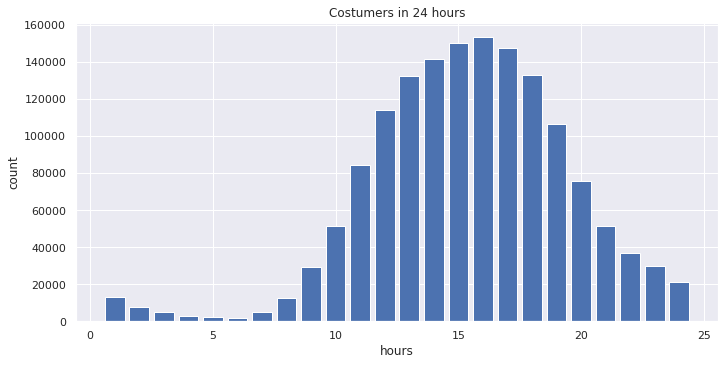

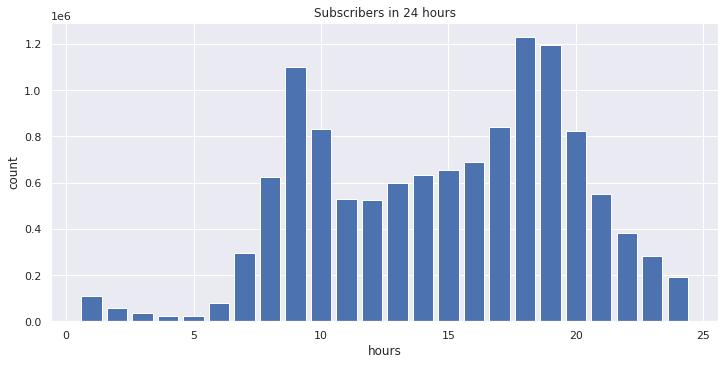

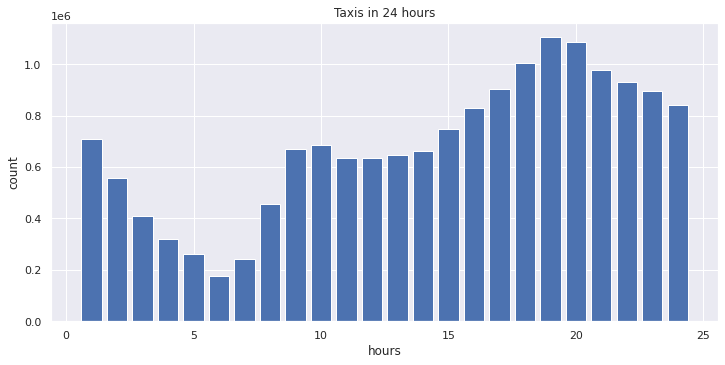

In [ ]:
plotDistribution(np.arange(1,25),costumer_dict["hour_count"],"hours", "Costumers in 24 hours")
plotDistribution(np.arange(1,25),subscriber_dict["hour_count"],"hours", "Subscribers in 24 hours")
plotDistribution(np.arange(1,25),taxi_dict["hour_count"],"hours", "Taxis in 24 hours")

From the subscriber and taxi plots the rush hours are clearly seen as peaks from 8-10 am and again from 5-8 pm. Whereas the costumers tend to use it along the day and has a nice bell-curve shape. 

Distribution of traffic during a week (7 days). (summed over the entire year)

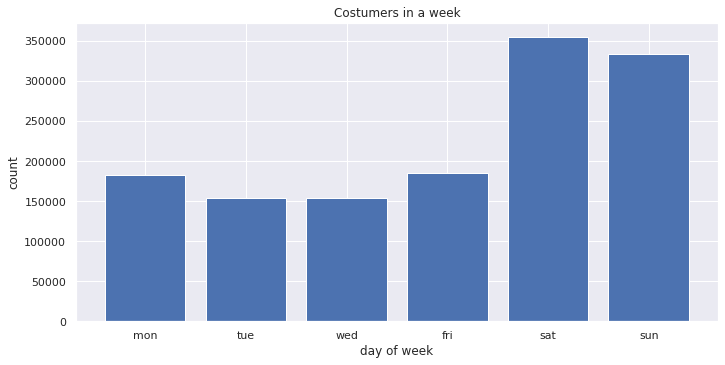

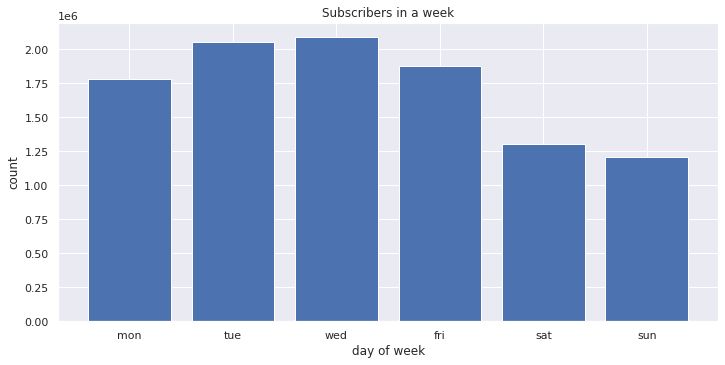

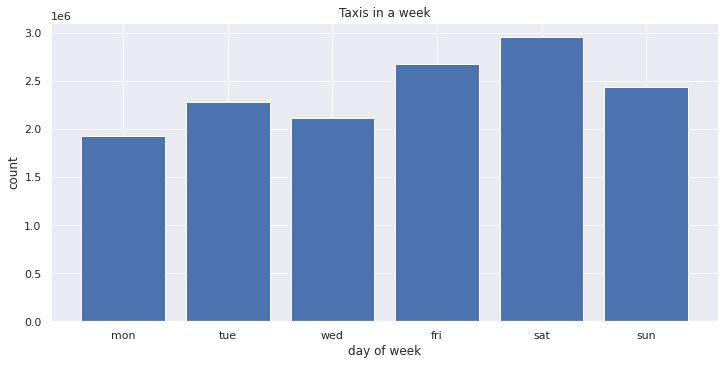

In [ ]:
plotDistribution(["mon", "tue", "wed", "tue", "fri", "sat", "sun"],costumer_dict["DOW_count"],"day of week", "Costumers in a week")
plotDistribution(["mon", "tue", "wed", "tue", "fri", "sat", "sun"],subscriber_dict["DOW_count"],"day of week", "Subscribers in a week")
plotDistribution(["mon", "tue", "wed", "tue", "fri", "sat", "sun"],taxi_dict["DOW_count"],"day of week", "Taxis in a week")

From the weekly plots the difference between costumers and subscribers are again clearly seen, as the subscribers mainly uses the bikes during work-days and costumers during weekends. The use of taxis are more evenly distributed but peaks in the weekends.

Distribution of traffic during a 2016 (12 months).

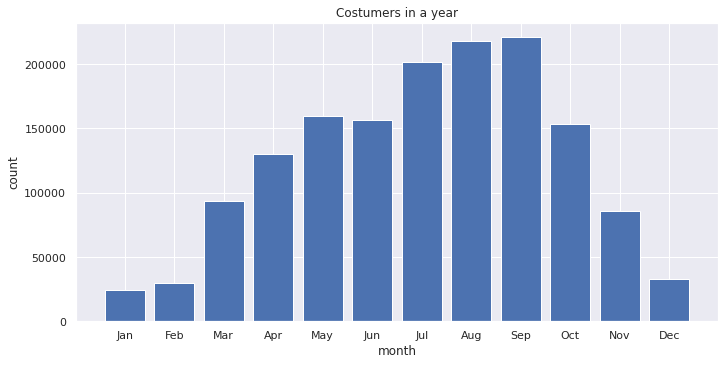

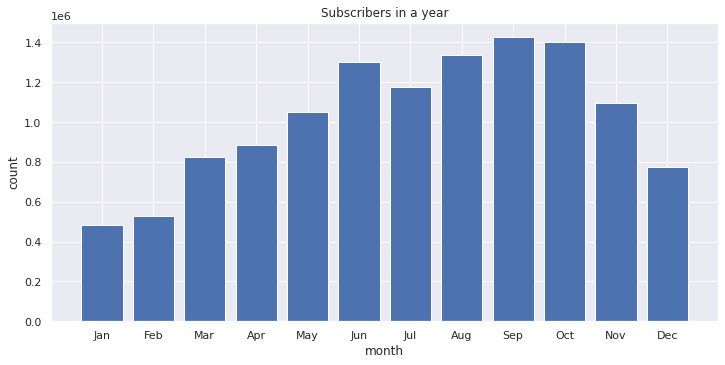

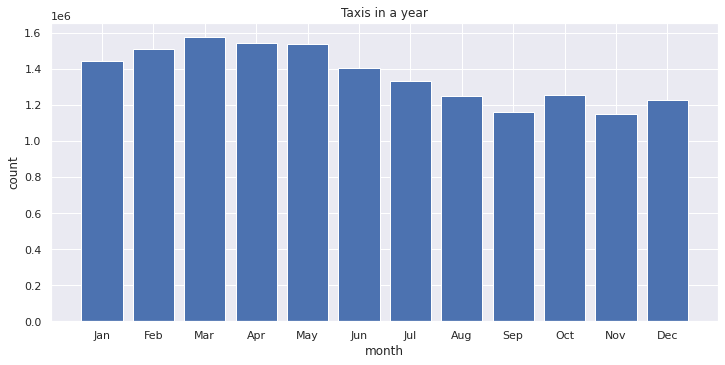

In [ ]:
months = ("Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec")

plotDistribution(months,costumer_dict["month_count"],"month", "Costumers in a year")
plotDistribution(months,subscriber_dict["month_count"],"month", "Subscribers in a year")
plotDistribution(months,taxi_dict["month_count"],"month", "Taxis in a year")

Looking at the plotting for the entire year it seems like the seasons have an impact on the biking in New York. For both costumers and subscribers the winter is the season with the least bikers and summer the season with the most. Furthermore the use of Taxis increases during the winter supports the idea of weather infuencing the bikers.

Distribution of traffic during a week (168 hours). (summed over the entire year)

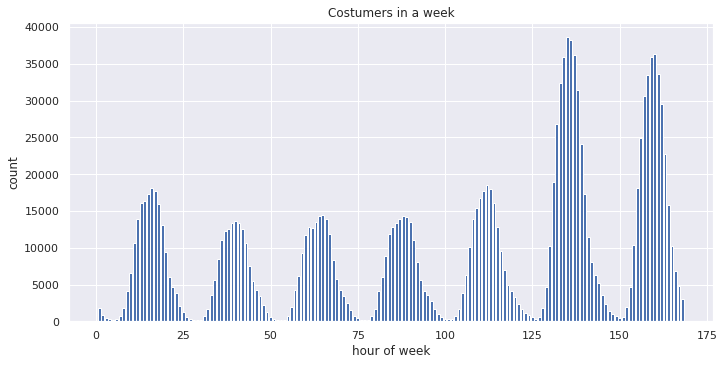

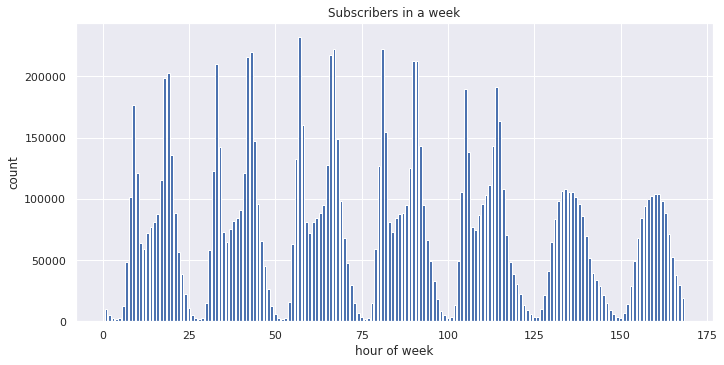

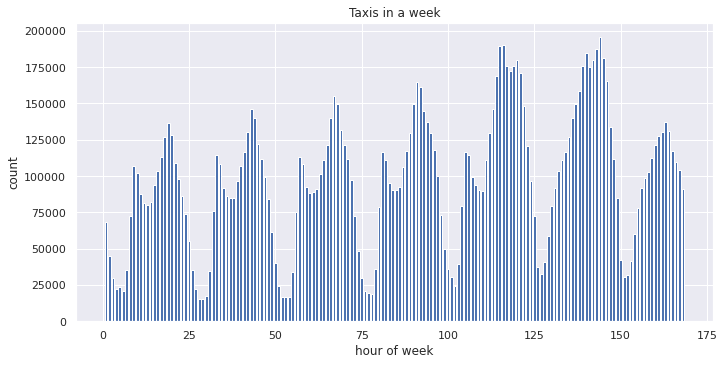

In [ ]:
plotDistribution(np.arange(1,169),costumer_dict["HOW_count"],"hour of week", "Costumers in a week")
plotDistribution(np.arange(1,169),subscriber_dict["HOW_count"],"hour of week", "Subscribers in a week")
plotDistribution(np.arange(1,169),taxi_dict["HOW_count"],"hour of week", "Taxis in a week")

Looking at subscribers the rush hour pattern becomes even more clear as these peaks vanishes during the weekend. 

To compare the different types of traffic a lineplot is made containing the load for each category during the year.

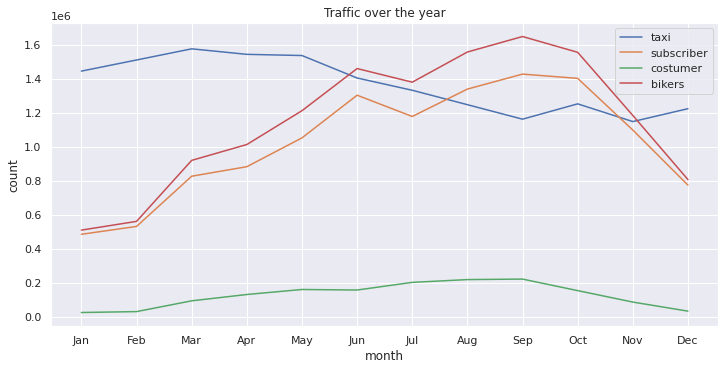

In [ ]:
months = ("Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec")
plt.figure(figsize=(10,5))  
plt.plot(months, taxi_dict["month_count"], label="taxi")
plt.plot(months, subscriber_dict["month_count"], label="subscriber")
plt.plot(months, costumer_dict["month_count"], label="costumer")
plt.plot(months, costumer_dict["month_count"]+subscriber_dict["month_count"], label="bikers")

plt.tight_layout()
plt.ylabel("count")
plt.xlabel("month")
plt.title("Traffic over the year")
plt.legend()
plt.show()

From the plot it can be seen how the use of City Bikes exceeds the use of Green Taxis for half a year (June-November).

### Concluding the descriptive analysis.

We can conclude that the behaviour of the citibike users is relatively represetative for the bike users in NY and not just something the turists mainly make us of. This is based the fact that the subscribers of citibikes show regular usage patterns that one can expect from 9-5 job commuters.

It is also intersting that the use of transport seems to be constant as the use of taxis goes down when an increse in bikeing is present, and also the other way around.

## 3.2 Comparison of taxi and bicycle commuters 

### Load

The taxi zones are loaded along with the average speed for each zone per hour of the day.

In [ ]:
with open('/content/drive/MyDrive/SocialDataFinalProject/TaxiData/NYC Taxi Zones.geojson') as json_file:
    data = json.load(json_file)

df_taxi_start = pd.read_csv("/content/drive/MyDrive/SocialDataFinalProject/TaxiData/taxi_STARTzone_speed_by_hour.csv")
df_taxi = pd.read_csv("/content/drive/MyDrive/SocialDataFinalProject/TaxiData/taxi_ENDzone_speed_by_hour.csv")
df_bike = pd.read_csv("/content/drive/MyDrive/SocialDataFinalProject/BikeData/2016/bike_zone_ENDspeed_by_hour.csv")


df_taxi_speed = pd.read_csv("/content/drive/MyDrive/SocialDataFinalProject/TaxiData/taxi_speed_by_hour.csv")
df_bike_speed = pd.read_csv("/content/drive/MyDrive/SocialDataFinalProject/BikeData/2016/bike_speed_by_hour.csv")

### Preprocess data

Create the folium map template for plotting.

In [ ]:
for d in data['features']:
  d['id'] = d['properties']['location_id'] 
lat = 40.760610 ; lon = -73.95242
# Create map
map_NY = folium.Map([lat, lon], zoom_start=12, zoom_control=False,)
folium.GeoJson(data, name="geojson").add_to(map_NY)

Add relative avarage zone speed to the Taxi data

In [ ]:
stations = list(df_taxi['end_station'].unique())
max_speed = np.zeros(len(stations))
for i, station in enumerate(stations):
  max_speed[i] = max(df_taxi[df_taxi['end_station'] == station]['avg_speed'])

max_speed_array = list(zip(stations,max_speed))
max_speed_dict = dict((x, y) for x, y in max_speed_array)
df_taxi['max_zone_speed'] = pd.Series(df_taxi['end_station']).map(max_speed_dict)
df_taxi['relative_avg_zone_speed'] = df_taxi['avg_speed']/df_taxi['max_zone_speed'] 

Add relative avarage zone speed to the Bike data

In [ ]:
stations = list(df_bike['end_station'].unique())
max_speed = np.zeros(len(stations))
for i, station in enumerate(stations):
  max_speed[i] = max(df_bike[df_bike['end_station'] == station]['avg_speed'])

max_speed_array = list(zip(stations,max_speed))
max_speed_dict = dict((x, y) for x, y in max_speed_array)
df_bike['max_zone_speed'] = pd.Series(df_bike['end_station']).map(max_speed_dict)
df_bike['relative_avg_zone_speed'] = df_bike['avg_speed']/df_bike['max_zone_speed'] 

### Plots

A generic method is creating for plotting with choropleth in order to make comparisons and plotting easier.

In [ ]:
def choroplot(df, hour, location_column, color_column, label, color_palette="Viridis", opacity=0.6, zoom = 10):
  df_hourly = df[df.Hour==hour]
  fig = px.choropleth_mapbox(df_hourly, geojson=data, locations=location_column, color=color_column,
                            color_continuous_scale=color_palette,
                            range_color=(0, max(df[color_column])),
                            mapbox_style="carto-positron",
                            zoom=zoom, center = {"lat": lat, "lon": lon},
                            opacity=opacity,
                            labels={color_column:label}
                            )
  fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
  fig.show()

#### Limitation on Green Taxi

Average speed based on the starting zone.

In [ ]:
#Plot of relative zone speed 4:00 am
choroplot(df_taxi_start, 1, 'start_station', 'avg_speed', 'average speed', color_palette='rainbow')

Midway through our analysis we plotted the average speed using the starting zones. However it seemed that we had no data for the lower part of Manhattan. After a deep dive into the data a quick google search revealed that the Green taxis of New York are actually not allowed to pick up passengers in hte lower part of Manhattan. And therefore the ending zone was used to represent the average speed of a zone.

#### Choropleth Plot - Relative zone speed

##### Taxi

Comparing the relative zone speed for 4:00 am in the morning and the rush hour at 5:00 pm respectively.

In [ ]:
#Plot of relative zone speed 4:00 am
choroplot(df_taxi, 4, 'end_station', 'relative_avg_zone_speed', 'max speed(%)', color_palette='rainbow')

In [ ]:
#Plot of relative zone speed 9:00 am
choroplot(df_taxi, 17, 'end_station', 'relative_avg_zone_speed', 'max speed(%)', color_palette='rainbow')

In the first plot we see that at 4:00 am in the morning where general traffic is light. The speeds of most of the zones are close to their respective maximum values. Then looking at the second plot representing the 5:00 pm rush hour the plot becomes very cold meaning that the average speed drastically decreases. In downtown Manhattan this can almost be a decrease of up to 60% and many arround 50%.

##### Bike

Now moving on to the same comparison for the bikes. Again the comparisons are made early in the morning and rush hour in the afternoon.

In [ ]:
choroplot(df_bike, 5, 'end_station', 'relative_avg_zone_speed', 'max speed', color_palette='rainbow',zoom=11.2)

In [ ]:
choroplot(df_bike, 17, 'end_station', 'relative_avg_zone_speed', 'max speed', color_palette='rainbow',zoom = 11.2)

Again we see a decrese in traveling speeds but the decreaese for the bikes is far less than for the taxis. The average decrese is around 20%-30%.

#### Speed during the day

Add normalized average speed to the data frame.

In [ ]:
df_taxi_speed['relative_speed'] = df_taxi_speed['avg_speed']/max(df_taxi_speed['avg_speed'])
df_bike_speed['relative_speed'] = df_bike_speed['avg_speed']/max(df_bike_speed['avg_speed'])

Plotting the the normalized average speed together.

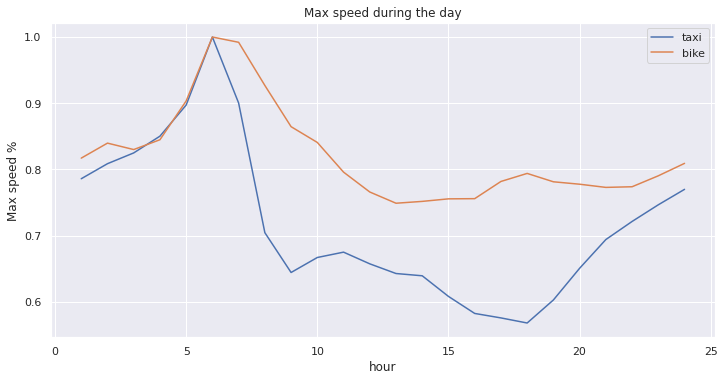

In [ ]:
hours = np.arange(1,25)
plt.figure(figsize=(10,5))  

plt.plot(hours, df_taxi_speed['relative_speed'], label="taxi")
plt.plot(hours, df_bike_speed['relative_speed'], label="bike")

plt.tight_layout()
plt.ylabel("Max speed %")
plt.xlabel("hour")
plt.title("Max speed during the day")
plt.legend()
plt.show()

From the graph it is shown how the traveling speed of bikes are less affected by traffic but it does follow the traffic of the taxis quite a bit indicating that it is somewhat dependant on the taxi infrastructure.

### Conclusion to comparison of taxi and bicycle commuters


These analysis conclude that bikes are less affected by traffic and show a more consistent average speed during the day. Taxis are 50 - 60% slower in the Manhattan area during rush hours while bikes only take a tip by 20-30%. This affect is probably gretaly explained the fact that the current bikeing infrastructure is not sufficient and bikers are therefore forced to use the infrastructure built arround cars.

## 3.3 Estimating travel time based on user input


### Imports and data preperation

Defining functions that later help with hte data preperation and loading the geo data for the Taxi zones.

In [ ]:
warnings.filterwarnings('ignore')
## Calculation the Haversine distance between two coordinates 
def haversine(coord1, coord2):
    R = 6372800  # Earth radius in meters
    lat1, lon1 = coord1
    lat2, lon2 = coord2
    
    phi1, phi2 = math.radians(lat1), math.radians(lat2) 
    dphi       = math.radians(lat2 - lat1)
    dlambda    = math.radians(lon2 - lon1)
    
    a = math.sin(dphi/2)**2 + \
        math.cos(phi1)*math.cos(phi2)*math.sin(dlambda/2)**2
    
    return 2*R*math.atan2(math.sqrt(a), math.sqrt(1 - a))
## Conversion of miles to meters
def miles_to_meters(x):
  return 1609.344*x

#Loading Geo data
with open('/content/drive/MyDrive/SocialDataFinalProject/TaxiData/NYC Taxi Zones.geojson') as json_file:
    data = json.load(json_file)
    
for d in data['features']:
  d['id'] = d['properties']['location_id'] 
#Defining the zones   
polygons = [(poly['id'], Polygon(poly['geometry']['coordinates'][0][0])) for poly in data['features']]

#Function for determining if a point is within a specific Taxi zone
def find_poly(point):
    for id, poly in polygons:
        if point.within(poly):
            return id

#### Bike data preparation

Due to the enormous amount of data we took a sample of 613.031 observations that we prepared for modeling.

In order to be able to compare the tow dataset quite some preperations needs to be done. First of we calclate the hversine distance and the average speed of each trip. After that we convert the datetime into variables such as hour and finally we map the starting and ending coordinates to the taxi zones.

In [ ]:
df_bike = pd.read_csv("/content/drive/MyDrive/SocialDataFinalProject/BikeData/2016/sampled_bike_data.csv",usecols = ['startstationlatitude','startstationlongitude','endstationlatitude',
                                 'endstationlongitude','starttime','stoptime','tripduration'],nrows=10000).dropna()
## Start/end position
df_bike['start_position'] = list(zip(df_bike["startstationlongitude"], df_bike["startstationlatitude"]))
df_bike['end_position'] = list(zip(df_bike["endstationlongitude"], df_bike["endstationlatitude"]))
# The Haversine distance in meters
df_bike['distance'] = df_bike.apply(lambda x: haversine(x.start_position, x.end_position), axis=1)
# Calculatin the average speed of the specific trip
df_bike['avg_speed'] = df_bike['distance']/df_bike['tripduration']
# Preparing new columns that describe what day, hour etc.
df_bike['date'] = pd.to_datetime(df_bike['starttime']).dt.floor('H')
df_bike['Month'] = pd.DatetimeIndex(df_bike['starttime']).month
df_bike['Day'] = pd.DatetimeIndex(df_bike['starttime']).day
df_bike['Hour'] = pd.DatetimeIndex(df_bike['starttime']).hour
# Gettig the start/end zone
df_bike['start_location'] = list(map(Point, zip(df_bike['startstationlongitude'], df_bike['startstationlatitude'])))
df_bike['end_location'] = list(map(Point, zip(df_bike['endstationlongitude'], df_bike['endstationlatitude'])))
df_bike['start_station'] = df_bike['start_location'].apply(find_poly)
df_bike['end_station'] = df_bike['end_location'].apply(find_poly)

In order to have some kind of an indicator of how fast one should be able to travel between zone x and y we calculated the average speed per hour for all of the possible routes. This variable was then merged to the dataframe based on the start_zone and the end_zone as well as the hour.



In [ ]:
# Average speed per path per hour
df_bike_group = df_bike[['start_station','end_station','Hour','avg_speed']].groupby(['start_station','end_station','Hour']).agg('mean')
df_bike_group.reset_index(inplace=True)
df_bike_group.head()

,start_station,end_station,Hour,avg_speed
0,100,100,5,1.294781
1,100,100,7,3.669026
2,100,100,9,0.000000
3,100,100,10,0.709871
4,100,100,18,2.618634


Trips that have a distance of 0 meters are most likely people going back and forth and are therefore impossible to use and are filtered. Also columns that are not to be used in the model are dropped.

In [ ]:
df_bike = df_bike.drop(columns =['startstationlatitude','startstationlongitude','endstationlatitude',
                                 'endstationlongitude','starttime','stoptime','start_position','end_position',
                      'avg_speed','start_location','end_location'] )[df_bike['distance']>0]
df_bike.head()

,tripduration,distance,date,Month,Day,Hour,start_station,end_station
0,641,2501.203500,2016-01-22 06:00:00,1,22,6,4,114
1,879,485.047170,2016-02-17 07:00:00,2,17,7,224,170
2,881,2357.794179,2016-01-07 08:00:00,1,7,8,170,144
3,1269,1268.321533,2016-03-08 10:00:00,3,8,10,148,68
4,1428,3130.294588,2016-03-12 15:00:00,3,12,15,68,239


#### Weather data preparation
The original data had a lot of different measuremants for an example from which direction or angle the wind was coming form and etc. Therefore a little dataprep was needed in order to get the meaningful numbers out of each column.

In [ ]:
df_weather = pd.read_csv("/content/drive/MyDrive/SocialDataFinalProject/JFK_weather_2016.csv",  usecols=['DATE','TMP', 'DEW', 'SLP','WND', 'CIG', 'VIS'])
for i in range(len(df_weather)):
    df_weather['WND'][i] = int(df_weather['WND'][i].split(',')[3])
    df_weather['CIG'][i] = int(df_weather['CIG'][i].split(',')[0])
    df_weather['VIS'][i] = int(df_weather['VIS'][i].split(',')[0])

df_weather['TMP'] = df_weather['TMP'].apply(lambda x: float(x.replace(',','.').replace('A','')))
df_weather['DEW'] = df_weather['DEW'].apply(lambda x: float(x.replace(',','.').replace('A','')))
df_weather['SLP'] = df_weather['SLP'].apply(lambda x: float(x.replace(',','.').replace('A','')))
df_weather['WND'] = df_weather['WND'].apply(lambda x: float(x))
df_weather['CIG'] = df_weather['CIG'].apply(lambda x: float(x))
df_weather['VIS'] = df_weather['VIS'].apply(lambda x: float(x))
df_weather['DATE'] = pd.to_datetime(df_weather['DATE']).dt.floor('H')
df_weather.drop_duplicates(subset = 'DATE',keep = False, inplace = True)
df_weather.head()

,DATE,WND,CIG,VIS,TMP,DEW,SLP
2,2016-01-01 01:00:00,72.0,1158.0,16093.0,78.5,-17.5,10193.5
3,2016-01-01 02:00:00,77.0,1158.0,16093.0,72.5,-22.5,10192.5
9,2016-01-01 05:00:00,57.0,1189.0,16093.0,61.5,-28.5,10182.5
12,2016-01-01 07:00:00,41.0,1097.0,16093.0,56.5,-28.5,10182.5
13,2016-01-01 08:00:00,36.0,1097.0,16093.0,61.5,-28.5,10181.5


Then we merge the data together in order to make the final dataframe to be used for the modeling

In [ ]:
#Mergind the average speed per zone per hour and the original bike dataframe.
bike_merged = pd.merge(df_bike,
        df_bike_group,
         how ='left',
       left_on = ['start_station','end_station','Hour'],
       right_on = ['start_station','end_station','Hour']
        )
#Adding the weather data to that data frame
bike_merged = pd.merge(bike_merged,
       df_weather ,
       how ='left',
       left_on = "date",
       right_on = "DATE"
       )
bike_merged = bike_merged.drop(columns =['date','DATE']).dropna()
bike_merged = bike_merged[bike_merged['tripduration']<2000]
bike_merged

,tripduration,distance,Month,Day,Hour,start_station,end_station,avg_speed,WND,CIG,VIS,TMP,DEW,SLP
1,879,485.047170,2,17,7,224,170,0.755538,93.0,4572.0,16093.0,33.5,-28.5,10095.5
2,881,2357.794179,1,7,8,170,144,2.186506,41.0,22000.0,16093.0,0.5,-100.5,10285.5
3,1269,1268.321533,3,8,10,148,68,0.999465,15.0,22000.0,16093.0,72.5,28.5,10203.5
7,483,1219.180401,3,13,20,143,239,2.524183,31.0,3962.0,16093.0,150.5,-6.5,10181.5
8,605,339.085183,3,9,17,234,186,1.092991,41.0,22000.0,16093.0,150.5,44.5,10186.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9864,164,81.145920,1,30,16,158,158,0.445945,31.0,7620.0,16093.0,17.5,-72.5,10189.5
9865,612,1855.857111,3,8,8,170,90,2.526953,21.0,2743.0,16093.0,67.5,28.5,10192.5
9866,432,1035.568995,2,18,18,164,170,2.734105,62.0,22000.0,16093.0,22.5,-150.5,10300.5
9867,273,791.486556,1,8,11,79,114,2.899218,36.0,22000.0,16093.0,6.5,-61.5,10234.5


#### Taxi Data preparation


First we load a sample of 2.000.000 from the sample of arround 16 million. We also just pick the variables we intend to use.

In [ ]:
# Loading a sample of size 2.000.000
filename = "/content/drive/MyDrive/SocialDataFinalProject/TaxiData/2016_Green_Taxi_Trip_Data.csv"
n = sum(1 for line in open(filename)) - 1 #number of records in file (excludes header)
s = 2000000 #desired sample size
skip = sorted(random.sample(range(1,n+1),n-s)) #the 0-indexed header will not be included in the skip list
df_green_taxi = pd.read_csv(filename, skiprows=skip , usecols=['lpep_pickup_datetime','Lpep_dropoff_datetime','Pickup_longitude','Pickup_latitude', 'Dropoff_longitude', 'Dropoff_latitude',
                                                                  'Passenger_count', 'Trip_distance', 'Fare_amount','Total_amount']).dropna()

First we merge the weather data.

In [ ]:
#Merging Weather data
df_green_taxi['date'] = pd.to_datetime(df_green_taxi['lpep_pickup_datetime']).dt.floor('H')
green_taxi_merged = pd.merge(df_green_taxi,
    df_weather,
       how ='left',
       left_on = "date",
       right_on = "DATE"
       )

And finally do similar operations as with the bike data.  First of we calculate the haversine distance and the average speed of each trip. After that we convert the datetime into variables such as hour and finally we map the starting and ending coordinates to the taxi zones.

In [ ]:

duration = pd.to_datetime(green_taxi_merged['Lpep_dropoff_datetime']) - pd.to_datetime(green_taxi_merged['lpep_pickup_datetime'])
for i in range(len(duration)):
  duration[i] = duration[i].total_seconds()

green_taxi_merged['duration'] = duration
green_taxi_merged['duration'][green_taxi_merged['duration']==0] = -1
green_taxi_merged['distance_meters'] = green_taxi_merged['Trip_distance'].apply(lambda x: miles_to_meters(x))
green_taxi_merged['avg_speed'] = green_taxi_merged['distance_meters'] / green_taxi_merged['duration']
green_taxi_merged['Hour'] = green_taxi_merged['date'].dt.hour
green_taxi_merged['Weekday'] = green_taxi_merged['date'].dt.weekday
green_taxi_merged['Month'] = green_taxi_merged['date'].dt.month
green_taxi_merged['avg_speed'] = green_taxi_merged['avg_speed'].apply(lambda x: float(x))
#Removing negative avarge speed
green_taxi_merged['avg_speed'][green_taxi_merged['avg_speed']< 0] = 0
#Setting outliers that are above the 0.998 percentile to the value of the 0.998 percentile
green_taxi_merged['avg_speed'][green_taxi_merged['avg_speed'] > 43] = 43
green_taxi_merged['duration'] =green_taxi_merged['duration'].apply(lambda x: float(x))
green_taxi_merged['start_location'] = list(map(Point, zip(green_taxi_merged['Pickup_longitude'], green_taxi_merged['Pickup_latitude'])))
green_taxi_merged['end_location'] = list(map(Point, zip(green_taxi_merged['Dropoff_longitude'], green_taxi_merged['Dropoff_latitude'])))
print('start starting')
green_taxi_merged['start_station'] = green_taxi_merged['start_location'].apply(find_poly)
print('end starting')
green_taxi_merged['end_station'] = green_taxi_merged['end_location'].apply(find_poly)

start starting
end starting


In [ ]:
df_taxi_group = green_taxi_merged[['start_station','end_station','Hour','avg_speed']].groupby(['start_station','end_station','Hour']).agg('mean')
df_taxi_group.reset_index(inplace=True)
df_taxi_group.head()

,start_station,end_station,Hour,avg_speed
0,1,1,4,0.00
1,1,1,5,0.00
2,1,1,6,10.75
3,1,1,8,0.00
4,1,1,12,0.00


At last the taxi group dataframe is merged to from the final dataframe ready to be used for the model training.

In [ ]:
taxi_merged = pd.merge(green_taxi_merged.drop(columns = ['DATE','lpep_pickup_datetime',
                                                         'Lpep_dropoff_datetime','Trip_distance','avg_speed','Pickup_longitude',
                                                        'Pickup_latitude','Dropoff_longitude','Dropoff_latitude',
                                                        'Passenger_count','Fare_amount','Total_amount',
                                                        'start_location','end_location']),
        df_taxi_group,
         how ='left',
       left_on = ['start_station','end_station','Hour'],
       right_on = ['start_station','end_station','Hour']
        )
taxi_merged = taxi_merged.bfill()
taxi_merged = taxi_merged[taxi_merged['duration']<2000].dropna()
taxi_merged = taxi_merged[taxi_merged['distance_meters'] != 0]

taxi_merged.head()

,date,WND,CIG,VIS,TMP,DEW,SLP,duration,distance_meters,Hour,Weekday,Month,start_station,end_station,avg_speed
0,2016-01-01,77.0,1158.0,16093.0,72.5,-22.5,10192.5,1215.0,6099.41376,0,4,1,181,228,6.119096
1,2016-01-01,77.0,1158.0,16093.0,72.5,-22.5,10192.5,588.0,3556.65024,0,4,1,152,24,5.911840
2,2016-01-01,77.0,1158.0,16093.0,72.5,-22.5,10192.5,164.0,724.20480,0,4,1,97,97,4.144840
3,2016-01-01,77.0,1158.0,16093.0,72.5,-22.5,10192.5,987.0,6582.21696,0,4,1,116,94,7.192586
4,2016-01-01,77.0,1158.0,16093.0,72.5,-22.5,10192.5,418.0,2848.53888,0,4,1,7,193,5.940745


### Training of the models

Both models are trained with a Random Forest regressor and a sample size of 100.000. This is due to computational and time limits. The models were then cross validated and saved for easier use. The reason for choosing at Random Forest is its nonlinear nature as well as its easy implementation. Below we go through making of the bike model but the method for the other models was exactly the same so these models will simply be loaded at the end.


In [ ]:
bike_merged = pd.read_csv('/content/drive/MyDrive/SocialDataFinalProject/BikeData/2016/bike_modeling_data.csv')
bike_merged = bike_merged[['WND','CIG','VIS','TMP','DEW','SLP','distance','Hour','DayOfWeek','Month','avg_speed','tripduration']]
#Sampling out of the dataframe
samplesize = 100000
bike_merged_sample = bike_merged.sample(samplesize)
#Transforming the dataframe into array for the model.
features = np.array(pd.get_dummies(bike_merged_sample.drop(columns = ['tripduration'])))
target = np.array(bike_merged_sample['tripduration'])


# Using Skicit-learn to split data into training and testing sets
train_features, test_features, train_labels, test_labels = train_test_split(features, target, test_size = 0.25)


# Instantiate model rf = RandomForestRegressor(n_estimators = 1000, min_samples_split=5)
# # Train the model on training data
#rf.fit(train_features, train_labels)

#saving the model after computation.
#joblib.dump(rf, 'rf_bike_regressor.pkl')

Loading the models and performing a simple prediction.

In [ ]:
rf_bike = joblib.load('/content/drive/MyDrive/SocialDataFinalProject/rf_bike_regressor2.pkl')

# Use the forest's predict method on the test data
predictions = rf_bike.predict(test_features)
# Calculate the absolute errors
errors = abs(predictions - test_labels)
# Print out the mean absolute error (mae)
print('Mean Absolute Error:', round(np.mean(errors), 2), 'seconds.')

Mean Absolute Error: 176.24 seconds.


The bike model performs on average within a 3 minutes. This is very acceptable as many factors can influence the travel time.

Loading the Taxi model

In [ ]:
taxi_merged = pd.read_csv('/content/drive/MyDrive/SocialDataFinalProject/TaxiData/taxidata_for_modeltraining.csv',dtype={'start_station': str, 'end_station':str})
taxi_merged = taxi_merged[['WND','CIG','VIS','TMP','DEW','SLP','distance_meters','Hour','Weekday','Month','avg_speed','duration']]
#Sampling out of the dataframe
samplesize = 100000
taxi_merged_sample = taxi_merged.sample(samplesize)
#Transforming the dataframe into array for the model.
features = np.array(pd.get_dummies(taxi_merged_sample.drop(columns = ['duration'])))
target = np.array(taxi_merged_sample['duration'])


# Using Skicit-learn to split data into training and testing sets
train_features, test_features, train_labels, test_labels = train_test_split(features, target, test_size = 0.25)
rf_taxi = joblib.load('/content/drive/MyDrive/SocialDataFinalProject/rf_taxi_regressor_2.pkl')

# Use the forest's predict method on the test data
predictions = rf_taxi.predict(test_features)
# Calculate the absolute errors
errors = abs(predictions - test_labels)
# Print out the mean absolute error (mae)
print('Mean Absolute Error:', round(np.mean(errors), 2), 'seconds.')

Mean Absolute Error: 141.02 seconds.


The taximodel performs on average within about 2 minutes. This is very acceptable as many factors can influence the travel time.

The models perform with 2-3 minutes accuracy for the test datasets which is very acceptable as a lot of different factors such as red light can slow down a persons journey within that timeframe. 



After these models were trained the "Prototype" of the user interface displayed in the website was made by simple user input functions in python. This implementation was then made more user-friendly on the website.

In [ ]:
df_taxi_group = pd.read_csv('/content/drive/MyDrive/SocialDataFinalProject/TaxiData/taxi_zone_speed_by_hour_STARTEND.csv')
weather_dict = df_weather.groupby(df_weather['DATE'].dt.month,as_index=False).agg('mean').to_dict(orient='index')
days = dict(zip(calendar.day_name, range(7))); 

month = int(input('What month is it?(numeric)\n'))
Hour = int(input('What hour of theday is it?(24hr clock)'))
Weekday = int(days[input('What day is it ?').capitalize()])
lat1 = float(input('What is your starting latitude?'))
long1 = float(input('What is your starting longitude?'))
lat2 = float(input('What is your ending latitude?'))
long2 = float(input('What is your ending longitude?'))
distance = haversine((lat1,long1),(lat2,long2))
start_station = find_poly(Point(long1,lat1))
end_station = find_poly(Point(long2,lat2))

avg_speed = df_taxi_group['avg_speed'][(df_taxi_group['start_station'] == '1') & 
                                      (df_taxi_group['end_station']=='1') & (df_taxi_group['Hour']==4)]
if len(avg_speed)==0:
    try:
      avg_speed = df_taxi_group['avg_speed'][(df_taxi_group['end_station']=='1') & (df_taxi_group['Hour']==4)].values[0]
    except:
      avg_speed = df_taxi_group['avg_speed'][(df_taxi_group['Hour']==Hour)].mean()
features = np.array([weather_dict[month-1]['WND'], 
 weather_dict[month-1]['CIG'],
 weather_dict[month-1]['VIS'],
 weather_dict[month-1]['TMP'],
 weather_dict[month-1]['DEW'],
 weather_dict[month-1]['SLP'],
 distance, Hour, Weekday,month ,avg_speed])

What month is it?(numeric)
1
What hour of theday is it?(24hr clock)3
What day is it ?monday
What is your starting latitude?40.17
What is your starting longitude?-73.97
What is your ending latitude?40.72
What is your ending longitude?-73.98


The impementation asks 7 different questions and collects them in a vector that afterwards is passed to the prediction. The prints shown above are terminal outputs from those input functions.

Loading the trained random forrest price regressor.

In [ ]:
rf_taxi_price = joblib.load('/content/drive/MyDrive/SocialDataFinalProject/rf_taxi_price_regressor.pkl')

Finally we can make predictions based on the user inputs and then present the user with choices based on both estimated travel times and the estimated price. The bike prices are based on the price of a single trip with the city bike, however if you are a subscriber this only costs 15 dollars a month. 

In [ ]:
##Taxi Duration preiction
taxi_duration = rf_taxi.predict([features])[0]
taxi_price = rf_taxi_price.predict([[distance,taxi_duration]])
bike_duration = rf_bike.predict([features])[0]
print(f'Your estimated travel time by taxi is {np.round(taxi_duration/60,2)} minutes' )
print(f'Your estimated price by taxi is {np.round(taxi_price[0],2)} $ dollars')
print(f'Your estimated travel time by bike is {np.round(bike_duration/60,2)} minutes' )
print(f'Your estimated price by bike is {np.round(3.5,2)} $ dollars' )


Your estimated travel time by taxi is 28.16 minutes
Your estimated price by taxi is 99.42 $ dollars
Your estimated travel time by bike is 25.77 minutes
Your estimated price by bike is 3.5 $ dollars


Above is an example of how the user is prompted with the information he/she need in order to make an informed decision based on both travel time and price.

Feature importances for both taxi and bike models

In [ ]:
list(zip(taxi_merged.columns, np.round(rf_taxi.feature_importances_,3), np.round(rf_bike.feature_importances_,3)))

[('WND', 0.023, 0.024),
 ('CIG', 0.017, 0.016),
 ('VIS', 0.003, 0.002),
 ('TMP', 0.026, 0.029),
 ('DEW', 0.024, 0.028),
 ('SLP', 0.033, 0.037),
 ('distance_meters', 0.586, 0.555),
 ('Hour', 0.024, 0.018),
 ('Weekday', 0.015, 0.018),
 ('Month', 0.01, 0.015),
 ('avg_speed', 0.24, 0.258)]

From the most important features it is clear to see that the distance of the trip aswell as average speed of the routes in the data set have the greatest impact on the results, which would be expected. Furthermore the weather condition seem to have suprisingly small importance for bikers as well as for taxis.

### Conclusion to estimating travel time based on user input

Looking at the trained models we can see that it is feasible to train a model predicting traveltime duration and pricing within a reasonable error margin (an avarage error on 175.41 seconds for bikes and 140.47 seconds for taxis). This is the machine under the hood for one of the main features on the website.

## 3.4 Bike data deepdive and recomendation for where to focus bike infrastructure investment.

In this section we will investigate the most trafficated routes based on the assumption that the shortest path algorithm yields the same route as a rational human would choose.

### Load

Load generated dictionaries for shortest paths between the different bike stations along with a dictionary containing the number of trips between any given station:

In [ ]:
with open("/content/drive/MyDrive/SocialDataFinalProject/Generated_data/merged_route_dict_final.pickle", "rb") as f:
  route_dict = pickle.load(f)

with open("/content/drive/MyDrive/SocialDataFinalProject/Generated_data/routes_final_count.pickle", "rb") as f:
  routes_final_count = pickle.load(f)

routes_final_count.sort(key=lambda tup: tup[1])
routes_count_final_dict = dict((x, y) for x, y in routes_final_count)

### Extract overlaping route segments

Filter data to contain top 500 trafficated routes:

In [ ]:
nodes = list(zip(*routes_final_count[-500:]))[0]
route_dict_filt= {key: route_dict.get(key) for key in nodes}

Function to extract route segments by the intersection of nodes on paths:

In [ ]:
def get_all_intersections(route_dict, length=1):
  route_set = set()
  route_count_dict_2 = route_dict.copy()

  for i, route in tqdm_notebook(route_dict.items()):
    if isinstance(route, list):
      route_count_dict_2.pop(i, None)
      for j, route_2 in route_count_dict_2.items():
        if isinstance(route_2, list):

          intersection = frozenset(set(route[1:-1]).intersection(set(route_2[1:-1])))
          if len(intersection) > length:
            route_set.add(intersection)

  return list(route_set)

Get overlapping segments for top 500 routes:

In [ ]:
route_set = get_all_intersections(route_dict_filt, length=1)

In [ ]:
print(f"number of overlapping route segments found: {len(route_set)}")

number of overlapping route segments found: 391


Function that takes a route segment and a dict of routes and 
  returns the indexes of the routes it is contained in

In [ ]:
def indexes_from_route(segment, route_dict):
  segment = np.array(list(segment))
  return [key for key, route in route_dict.items() if np.all(np.isin(segment, route))]

Get route indicies for each overlapping segment:

In [ ]:
route_indices = [indexes_from_route(segment, route_dict_filt) for segment in route_set]

Calculate total count on overlapping segments:

In [ ]:
overlapcounts = np.zeros(len(route_indices))
for i, set_of_routes in enumerate(route_indices):
  count = 0
  for route in set_of_routes: 
    count =+ routes_count_final_dict[route]
  overlapcounts[i] = count

overlap_count_array = list(zip(route_set,overlapcounts))
overlap_count_dict = dict((x, y) for x, y in overlap_count_array)

### Map routes

Create Color dict: 

In [ ]:
blue = Color("cyan")
colors = list(blue.range_to(Color("blue"),int(routes_final_count[-6][1])+1))
color_array = list(zip(np.arange(int(routes_final_count[-1][1])+1),colors))
color_dict = dict((x, y) for x, y in color_array)

Load NYC Street Network Graph:

In [ ]:
new_york_graph = ox.graph_from_place("New York City, New York", network_type="bike", truncate_by_edge=True)

Plot most trafficated routes with color density matching traffic load 

In [ ]:
#plot map
m = ox.plot_route_folium(new_york_graph, route_dict_filt[101737], route_opacity =0.01, weight=3)

#plot top 500 most trafficated routes with different color intensity 
for route in nodes:
  if len(route_dict[route]) > 1:
    ox.plot_route_folium(new_york_graph, route_dict[route], color=str(color_dict[routes_count_final_dict[route]]), route_opacity =0.9,  route_map=m, weight=3)

for overlap in route_set:
  try:
    ox.plot_route_folium(new_york_graph, list(overlap), route_color=str(color_dict[overlap_count_dict[overlap]]),  route_map=m, weight=3)
  except:
    continue

m

The plot shows the most used biking paths in new york area. From the colouring of the route segments it is clear that some routes are busier than others. 

With the use of google street view we can look closer into the heavily trafficated routes seen on the map above.  

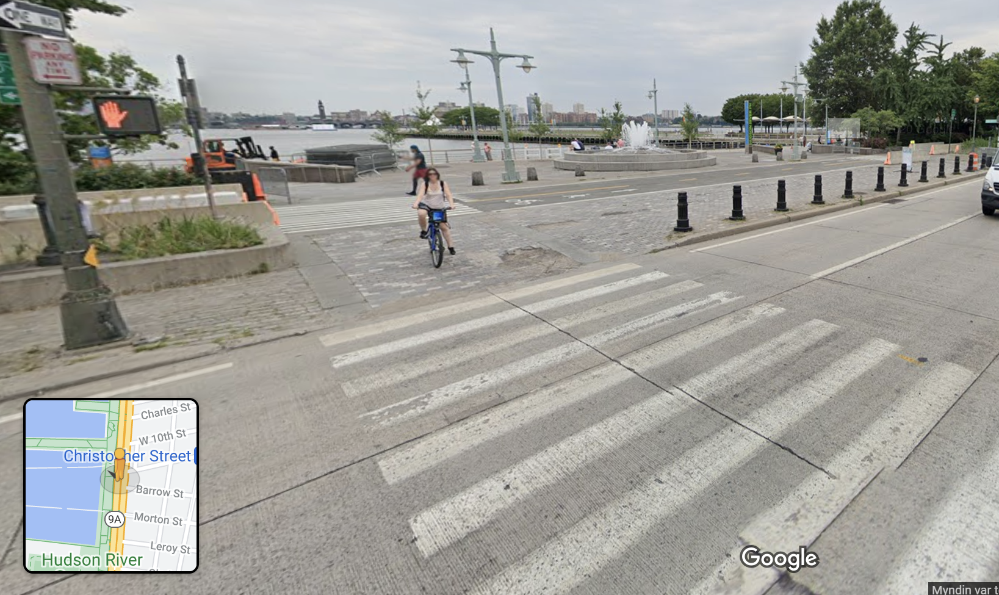

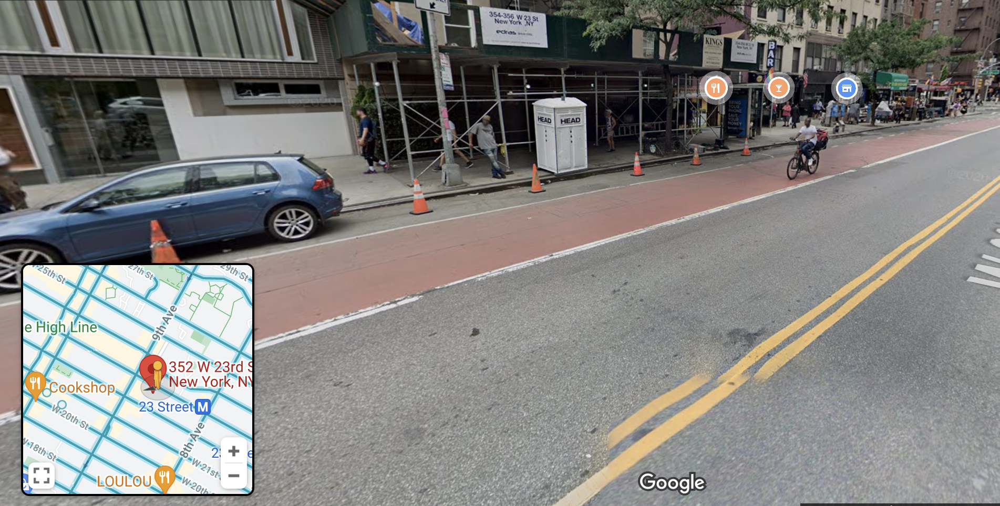

### Conclusion for bike data deepdive and recomendation for where to focus bike infrastructure investment.

In these pictures two of the most trafficated routes are captured. The one by the coast (the upper picture) seems to have great infrastructure which results in it being one of the most used parth in New York.The lower picture also shows a popular biking route which is likely due to the fact that cyclist can use the bus lane. This indicates that people tend to bike where the infrastructure allows for it. 

The routes on the maps are the most heavily uesd routes of new york and proper bikeing infrastructure should be focuses arround serving these areas.

# Genre

##### **Main Genre**
The main Genre for the webpage is **Magazine Style** / **Annotated Graph / Map** - the subject evolves heavily around maps and the Magazine Style supports the storytelling, leading the user slowly through each step by scrolling through the webpage.

##### **Visual Narrative**
For the **Visual Structuring**, a progress bar appears in form of the scroller in the webpage, this gives an idea of how far you are on the website. The **Highlighting** used are Close-ups - used in form of google street view pictures to establish a connection to the maps earlier plotted. Furthermore, Zooming is available in all the maps plotted on the webpage, which add more interactivity. We do not have any **Transition Guidance** beside the scrolling.


##### **Narrative Structure**
We have used Linear **Ordering** - this slowly guides the user through every step of our story. For **Interactivity** we have the following features: Hover Highlighting / Details, Filtering / Selection / Search, these all adds to the engagement of the users and encourages the user two play with it. For **Messaging** we have used the following features:  Captions / Headlines, Annotations, Introductory Text, Summary / Synthesis. These are basic elements that supports the storytelling.


# Visualizations

For Visualization the following elements have been chosen:

**Bar plots for basic distributions** – have been chosen since difference in lengths are some of easiest differences detectable by the human eye, thus using bar plots easily establishes a fast overview of the traffic in the city during the year. 

**Line plots for comparing taxi and bike data in time** – Line plots have been chosen when comparing counts and speed of transportation types over time measured against each other, since the continuity of the line plots has a great effect when comparing elements over time.

**Choropleth plots for the individual zones** – choropleth have been chosen to illustrate the average speed of bikes and taxis during the day. The change of color intensity is in general a hard task for the eye to detect, but the color spectrum chosen is very wide for these plots which makes it easy to interpret. The Choropleth plots have been chosen over heatmaps to retain the structure of the map. Besides this it also adds the notion of city districts to the map.  

**Folium network plot for plots of routes** – The plot of the possibly most trafficated routes is illustrated via OSMnx and folium. OSMnx is a package used to illustrate street networks and folium adds the NYC map layout needed for the graph to be projected onto. The illustration can be a bit hard to interpret very precisely due to the difficulty task of detecting color intensity changes. However, the intention of the plot is to give a more holistic picture of the bike traffic since assumptions on routes are already made with the shortest path algorithm.

**Pictures in google street view to pin down examples** – The Google street view pictures creates a familiar element for the readers and makes the result of the more abstract calculations more actual and easier to deal with. Furthermore, the pictures also work as validation of the route segments investigated, do they seem heavily trafficated? The last picture clearly states that the bike infrastructure could be improved which support the goal of the project.


# Discussion

The project was ambitous from the start but the main ideas we got from the start we were able to execute. We showed that bicycles are less prone to traffic and thereby more reliable and a cheaper option. The group worked like a whole throughout the whole project and each individuals strengths were utilized. To sum up things went according to plan and the group also managed to execute a lot of the things that from the start were thought of as nice to haves. 

Setting up the website also turned out to be less of an headache than expected. This is main because of a great platform idea from one of the group members and his coding skills. However running such user interactivity demanded a virtual machine or a server to be able to do the computations. This made the website slower and made the interactivity and user experience less appealing. Certainly better solutions could have been implemented with a bit more time on our hands.

Form the start we were working with a lot of data. This lead to slow computing times and some time spend simply waiting for the computer to finish. This should have been cut down from the start. We were of course afraid that using a smaller sample would hurt the overall perfomance of the models or even skew some of our distributions but it turned out that the accuracy gains were neglectable in relation to the time spent waiting.

# Contributions



1.   Motivation - **Andri**
2.   Basic stats - **Asger**
3.   Data Analysis - **Andri/Asger/Evangelos**
   * 3.1 Descriptive analytics - **Asger**
   * 3.2 Comparison of taxi and bicycle commuters - **Asger**
   * 3.3 Estimating travel time based on user input - **Andri**
   * 3.4 Bike data deepdive and recomendation for where to focus bike infrastructure investment. -  **Asger/Evangelos**
4.   Genre - **Evangelos**
5.   Visualizations **Asger**
6.   Discussion **Andri**
7.   Website - **Evangelos**








In [ ]:
*